# Lab-5.1: Python GeoPandas & Folium

**Author**: Amit Arora

**Instructions** 

**Demonstration section:** The instructors will work through this section during the lab period. It is meant to be educational, with various code examples provided for you. You should understand all code in the demonstration section and should run the cells on your local machine before attempting the assignment

**Download**: ![Click here](lab-5.1.ipynb.zip) to download the notebook to follow along

**Submission:** No lab assignment this week, use the time to work on your projects. 

**NOTE**: It is recommended that you complete this `.ipynb` file in VS Code. Activate the `anly503` environment by selecting the kernel in the upper-right corner of VS-code. 

## Demonstration

Before starting the assignment, lets work through the various sub-components needed.

### Import

Install the `folium` package.

In [74]:
!pip install folium==0.14.0 geopy==2.3.0 geopandas==0.12.2

In [75]:
import folium
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
%matplotlib inline
from folium.plugins import HeatMap
from geopy.geocoders import Nominatim
from folium.plugins import MarkerCluster
from folium.plugins import HeatMapWithTime

### Data

In [76]:
# Load the dataset
df = pd.read_parquet('https://bigdatateaching.s3.amazonaws.com/nyc-taxi-2016/nyc_taxi_2016.parquet')

## Exploratory Data Analysis



Let us get the shape of the dataframe to see the size of the data we are dealing with.


In [77]:
print(f"shape of the dataframe is {df.shape[0]:,}x{df.shape[1]}")

shape of the dataframe is 1,458,644x11


Note the `pickup_longitude`, `pickup_latitude`, `dropoff_longitude`, `dropoff_latitude` columns, these are the columns we would be using for plotting this dataset on a map.

In [78]:
## Down-sample (optional)
df=df.sample(frac=0.035)

print(f"shape of the dataframe is {df.shape[0]:,}x{df.shape[1]}")

shape of the dataframe is 51,053x11


In [79]:
# Preview the dataset
df.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration
1269954,id0433586,2,2016-01-30 17:50:11,2016-01-30 18:00:40,1,-73.974747,40.783150,-73.980812,40.764931,N,629
325191,id3644368,2,2016-02-04 13:54:19,2016-02-04 13:56:23,1,-73.967308,40.793159,-73.974640,40.785011,N,124
114873,id1049519,2,2016-03-21 21:03:54,2016-03-21 21:11:06,1,-73.973297,40.754360,-73.984627,40.732121,N,432
56881,id0911111,2,2016-05-23 13:35:34,2016-05-23 13:54:17,2,-73.980988,40.758678,-73.962257,40.779240,N,1123
754346,id1411839,2,2016-01-14 16:12:45,2016-01-14 16:18:25,1,-74.008087,40.739521,-74.009720,40.722435,N,340


In [80]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 51053 entries, 1269954 to 254660
Data columns (total 11 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   id                  51053 non-null  object 
 1   vendor_id           51053 non-null  int64  
 2   pickup_datetime     51053 non-null  object 
 3   dropoff_datetime    51053 non-null  object 
 4   passenger_count     51053 non-null  int64  
 5   pickup_longitude    51053 non-null  float64
 6   pickup_latitude     51053 non-null  float64
 7   dropoff_longitude   51053 non-null  float64
 8   dropoff_latitude    51053 non-null  float64
 9   store_and_fwd_flag  51053 non-null  object 
 10  trip_duration       51053 non-null  int64  
dtypes: float64(4), int64(3), object(4)
memory usage: 4.7+ MB


### GeoPandas

Let us first explore the dataset with `GeoPandas`. We start with plotting the pickup and dropoff locations as a simple scatter plot using `matplotlib`. Notice that these plots automatically resemble the shape of New York City.

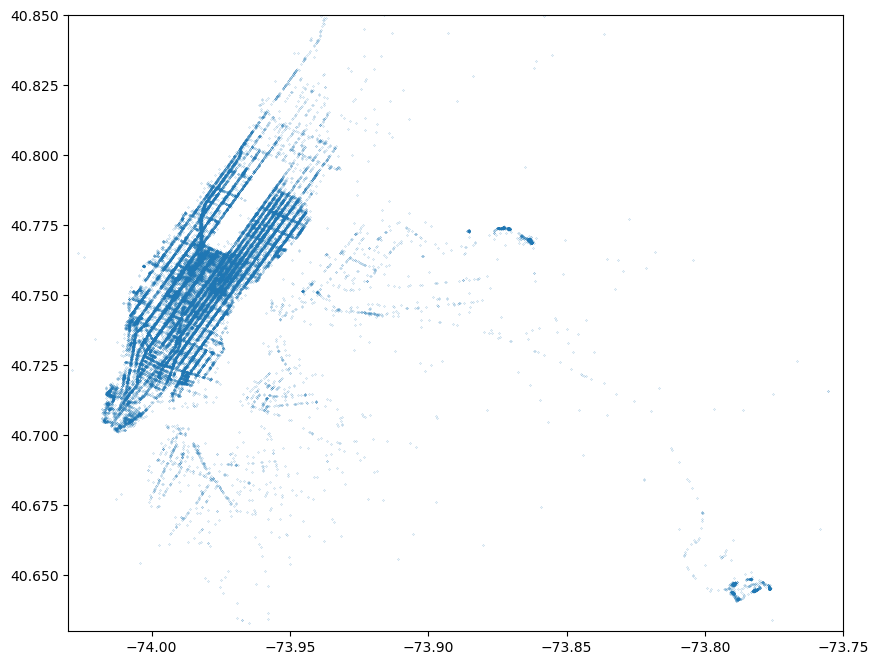

In [81]:
# visualizing passenger pickup locations
fig, ax = plt.subplots(ncols=1, nrows=1,figsize=(10,8))
plt.ylim(40.63, 40.85)
plt.xlim(-74.03,-73.75)
ax.scatter(df['pickup_longitude'],df['pickup_latitude'], s=0.02, alpha=1)

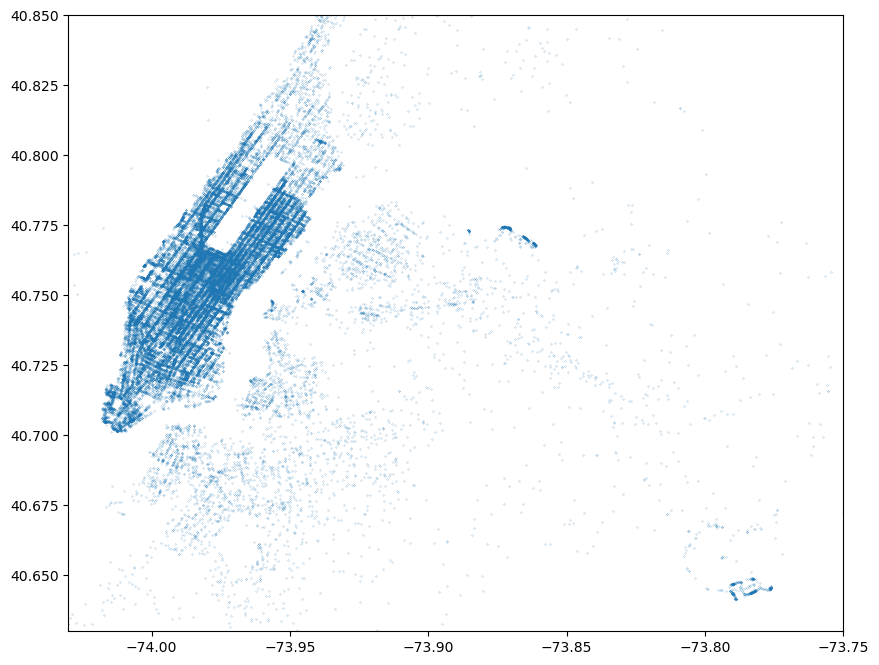

In [82]:
# visualizing passenger dropoff locations
fig, ax = plt.subplots(ncols=1, nrows=1,figsize=(10,8))
plt.ylim(40.63, 40.85)
plt.xlim(-74.03,-73.75)
ax.scatter(df['dropoff_longitude'],df['dropoff_latitude'], s=0.02, alpha=1)

Now let us use `GeoPandas` to plot the New York City burroughs, this is easy because `GeoPandas` comes with the `nybb` dataset that has the geometry/shape information to do this.

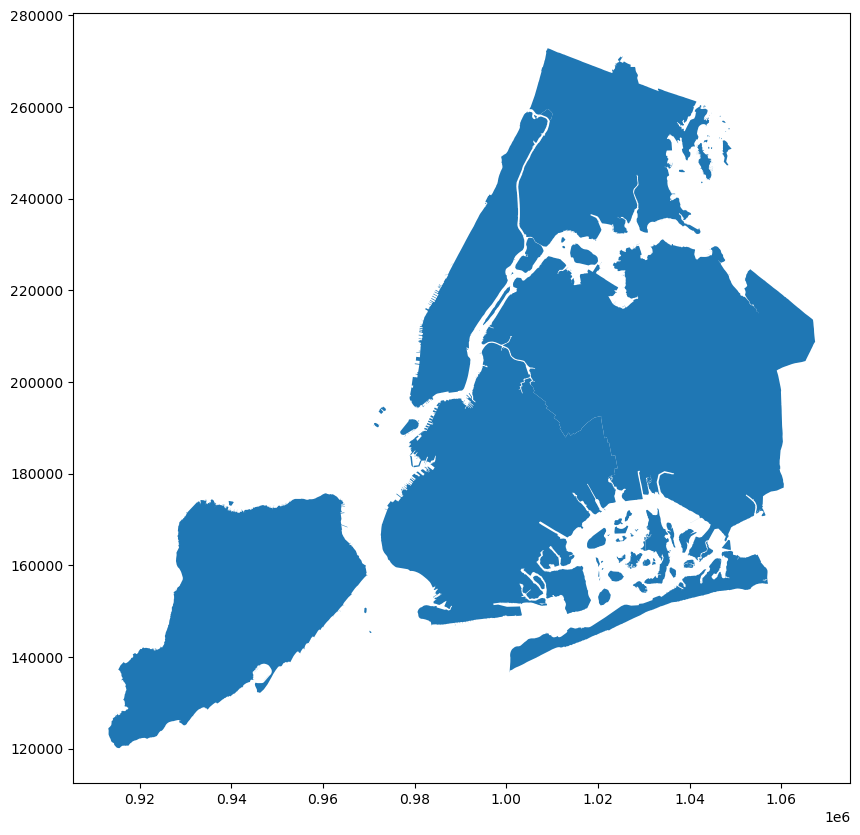

In [83]:
# getting New York City map from Geopandas
nyc = gpd.read_file(gpd.datasets.get_path('nybb'))
ax = nyc.plot(figsize=(12, 10))

We can do this better by using the shape files available from `https://data.cityofnewyork.us/api/geospatial/d3c5-ddgc?method=export&format=Shapefile` in the form of a single zip file. The zip file actually contains 4 files and we need all 4 of them. To make things easier, the 4 files have already been downloaded and made available in the [datasets](https://github.com/anly503/datasets) repo so here we are just going to download these files from there.

In [84]:
import requests
import os

shape_files = ['https://github.com/anly503/datasets/raw/main/nyc-shape-files/geo_export_0c35ce5c-c15b-46b5-9303-1c5a64b2472d.shp',
               'https://github.com/anly503/datasets/raw/main/nyc-shape-files/geo_export_0c35ce5c-c15b-46b5-9303-1c5a64b2472d.dbf',
               'https://raw.githubusercontent.com/anly503/datasets/main/nyc-shape-files/geo_export_0c35ce5c-c15b-46b5-9303-1c5a64b2472d.prj',
               'https://github.com/anly503/datasets/raw/main/nyc-shape-files/geo_export_0c35ce5c-c15b-46b5-9303-1c5a64b2472d.shx']

for f in shape_files:
    r = requests.get(f, allow_redirects=True)
    open(os.path.basename(f), 'wb').write(r.content)

In [85]:
zones = gpd.read_file('geo_export_0c35ce5c-c15b-46b5-9303-1c5a64b2472d.shp').to_crs({'init' :'epsg:4326'})
zones.head()

/Users/jameshickman/miniconda3/envs/anly503/lib/python3.10/site-packages/pyproj/crs/crs.py:141: FutureWarning:

'+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6



,borough,location_i,objectid,shape_area,shape_leng,zone,geometry
0,EWR,1.0,1.0,0.000782,0.116357,Newark Airport,"POLYGON ((-74.18445 40.69500, -74.18449 40.695..."
1,Queens,2.0,2.0,0.004866,0.433470,Jamaica Bay,"MULTIPOLYGON (((-73.82338 40.63899, -73.82277 ..."
2,Bronx,3.0,3.0,0.000314,0.084341,Allerton/Pelham Gardens,"POLYGON ((-73.84793 40.87134, -73.84725 40.870..."
3,Manhattan,4.0,4.0,0.000112,0.043567,Alphabet City,"POLYGON ((-73.97177 40.72582, -73.97179 40.725..."
4,Staten Island,5.0,5.0,0.000498,0.092146,Arden Heights,"POLYGON ((-74.17422 40.56257, -74.17349 40.562..."


Now plot the map and colorize by boroughs.

<AxesSubplot: >

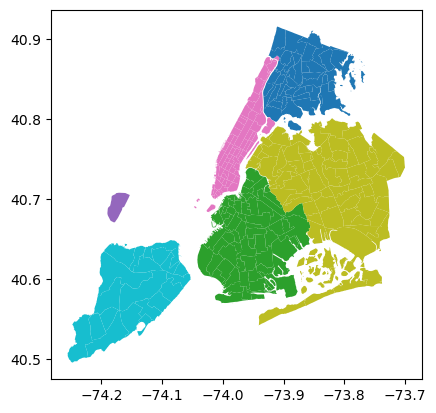

In [86]:
zones.plot(column='borough', categorical=True)

#### Find out the zones and boroughs that form the most common pickup and dropoff locations

To do this, we will convert our Pandas dataframe into a `GeoPandas` dataframe (see [this](https://geopandas.org/en/stable/gallery/create_geopandas_from_pandas.html) link) and then join it with the zones dataframe so that for each trip (row of the dataframe) we have the pickup and dropoff zone and borough. 

1. We have to do this in two steps, once for the pickup location and once for the dropoff locations because a geopandas dataframe can have a single geometry column at a time.

1. We will join the geopandas dataframe with the zones dataframe using [`sjoin`](https://geopandas.org/en/stable/docs/reference/api/geopandas.sjoin.html) and we use the predicate `within` to say that if a pickup/dropoff location is within the polygon of a zones dataframe row then that is when the join happens.

In [87]:
geo_df_pu = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.pickup_longitude, df.pickup_latitude), crs={'init' :'epsg:4326'})
geo_df_pu.head()

/Users/jameshickman/miniconda3/envs/anly503/lib/python3.10/site-packages/pyproj/crs/crs.py:141: FutureWarning:

'+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6



,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,geometry
1269954,id0433586,2,2016-01-30 17:50:11,2016-01-30 18:00:40,1,-73.974747,40.783150,-73.980812,40.764931,N,629,POINT (-73.97475 40.78315)
325191,id3644368,2,2016-02-04 13:54:19,2016-02-04 13:56:23,1,-73.967308,40.793159,-73.974640,40.785011,N,124,POINT (-73.96731 40.79316)
114873,id1049519,2,2016-03-21 21:03:54,2016-03-21 21:11:06,1,-73.973297,40.754360,-73.984627,40.732121,N,432,POINT (-73.97330 40.75436)
56881,id0911111,2,2016-05-23 13:35:34,2016-05-23 13:54:17,2,-73.980988,40.758678,-73.962257,40.779240,N,1123,POINT (-73.98099 40.75868)
754346,id1411839,2,2016-01-14 16:12:45,2016-01-14 16:18:25,1,-74.008087,40.739521,-74.009720,40.722435,N,340,POINT (-74.00809 40.73952)


In [88]:
geo_df_pu = gpd.sjoin(geo_df_pu, zones[['zone', 'borough', 'geometry']], how="left", predicate="within")

geo_df_pu.drop(['geometry', 'index_right'], axis=1, inplace=True)
geo_df_pu.rename({"zone": "zone_pu", "borough": "borough_pu"}, axis=1, inplace=True)

geo_df_pu.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,zone_pu,borough_pu
1269954,id0433586,2,2016-01-30 17:50:11,2016-01-30 18:00:40,1,-73.974747,40.783150,-73.980812,40.764931,N,629,Upper West Side South,Manhattan
325191,id3644368,2,2016-02-04 13:54:19,2016-02-04 13:56:23,1,-73.967308,40.793159,-73.974640,40.785011,N,124,Upper West Side North,Manhattan
114873,id1049519,2,2016-03-21 21:03:54,2016-03-21 21:11:06,1,-73.973297,40.754360,-73.984627,40.732121,N,432,Midtown East,Manhattan
56881,id0911111,2,2016-05-23 13:35:34,2016-05-23 13:54:17,2,-73.980988,40.758678,-73.962257,40.779240,N,1123,Midtown Center,Manhattan
754346,id1411839,2,2016-01-14 16:12:45,2016-01-14 16:18:25,1,-74.008087,40.739521,-74.009720,40.722435,N,340,Meatpacking/West Village West,Manhattan


In [89]:
geo_df_do = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.dropoff_longitude, df.dropoff_latitude), crs={'init' :'epsg:4326'})
geo_df_do.head()

/Users/jameshickman/miniconda3/envs/anly503/lib/python3.10/site-packages/pyproj/crs/crs.py:141: FutureWarning:

'+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6



,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,geometry
1269954,id0433586,2,2016-01-30 17:50:11,2016-01-30 18:00:40,1,-73.974747,40.783150,-73.980812,40.764931,N,629,POINT (-73.98081 40.76493)
325191,id3644368,2,2016-02-04 13:54:19,2016-02-04 13:56:23,1,-73.967308,40.793159,-73.974640,40.785011,N,124,POINT (-73.97464 40.78501)
114873,id1049519,2,2016-03-21 21:03:54,2016-03-21 21:11:06,1,-73.973297,40.754360,-73.984627,40.732121,N,432,POINT (-73.98463 40.73212)
56881,id0911111,2,2016-05-23 13:35:34,2016-05-23 13:54:17,2,-73.980988,40.758678,-73.962257,40.779240,N,1123,POINT (-73.96226 40.77924)
754346,id1411839,2,2016-01-14 16:12:45,2016-01-14 16:18:25,1,-74.008087,40.739521,-74.009720,40.722435,N,340,POINT (-74.00972 40.72243)


In [90]:
geo_df_do = gpd.sjoin(geo_df_do, zones[['zone', 'borough', 'geometry']], how="left", predicate="within")

geo_df_do.drop(['geometry', 'index_right'], axis=1, inplace=True)
geo_df_do.rename({"zone": "zone_do", "borough": "borough_do"}, axis=1, inplace=True)

geo_df_do.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,zone_do,borough_do
1269954,id0433586,2,2016-01-30 17:50:11,2016-01-30 18:00:40,1,-73.974747,40.783150,-73.980812,40.764931,N,629,Midtown North,Manhattan
325191,id3644368,2,2016-02-04 13:54:19,2016-02-04 13:56:23,1,-73.967308,40.793159,-73.974640,40.785011,N,124,Upper West Side South,Manhattan
114873,id1049519,2,2016-03-21 21:03:54,2016-03-21 21:11:06,1,-73.973297,40.754360,-73.984627,40.732121,N,432,East Village,Manhattan
56881,id0911111,2,2016-05-23 13:35:34,2016-05-23 13:54:17,2,-73.980988,40.758678,-73.962257,40.779240,N,1123,Central Park,Manhattan
754346,id1411839,2,2016-01-14 16:12:45,2016-01-14 16:18:25,1,-74.008087,40.739521,-74.009720,40.722435,N,340,TriBeCa/Civic Center,Manhattan


Now we will combine the pickup and dropoff dataframes so that we have the zone and borough for both pickup and dropoff locations.

In [91]:
gdf_pu_do = pd.merge(geo_df_do, geo_df_pu, how="inner")
gdf_pu_do

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,zone_do,borough_do,zone_pu,borough_pu
0,id0433586,2,2016-01-30 17:50:11,2016-01-30 18:00:40,1,-73.974747,40.783150,-73.980812,40.764931,N,629,Midtown North,Manhattan,Upper West Side South,Manhattan
1,id3644368,2,2016-02-04 13:54:19,2016-02-04 13:56:23,1,-73.967308,40.793159,-73.974640,40.785011,N,124,Upper West Side South,Manhattan,Upper West Side North,Manhattan
2,id1049519,2,2016-03-21 21:03:54,2016-03-21 21:11:06,1,-73.973297,40.754360,-73.984627,40.732121,N,432,East Village,Manhattan,Midtown East,Manhattan
3,id0911111,2,2016-05-23 13:35:34,2016-05-23 13:54:17,2,-73.980988,40.758678,-73.962257,40.779240,N,1123,Central Park,Manhattan,Midtown Center,Manhattan
4,id1411839,2,2016-01-14 16:12:45,2016-01-14 16:18:25,1,-74.008087,40.739521,-74.009720,40.722435,N,340,TriBeCa/Civic Center,Manhattan,Meatpacking/West Village West,Manhattan
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51048,id1201742,1,2016-02-25 11:24:20,2016-02-25 11:47:44,1,-73.974983,40.757164,-74.015434,40.709427,N,1404,Battery Park City,Manhattan,Midtown Center,Manhattan
51049,id1229387,2,2016-06-02 09:32:31,2016-06-02 10:08:30,2,-73.871010,40.773865,-73.950806,40.780983,N,2159,Yorkville West,Manhattan,LaGuardia Airport,Queens
51050,id1289052,1,2016-06-24 15:49:32,2016-06-24 16:27:10,4,-73.986160,40.753056,-73.986160,40.753056,N,2258,Garment District,Manhattan,Garment District,Manhattan
51051,id2567248,1,2016-06-01 21:06:36,2016-06-01 21:16:51,1,-73.993538,40.757099,-73.976234,40.748924,N,615,Murray Hill,Manhattan,Clinton East,Manhattan


Counts for pickup and droppoff locations considering both zone and borough. This is a long tailed distribution as even the most frequently occuring combination only accounts of 0.5% of the total trips.

In [92]:
gdf_pu_do.value_counts(["zone_pu", "borough_pu", "zone_do", "borough_do"], normalize=True).mul(100).reset_index(name="trips")

,zone_pu,borough_pu,zone_do,borough_do,trips
0,Upper East Side South,Manhattan,Upper East Side North,Manhattan,0.524620
1,Upper East Side North,Manhattan,Upper East Side South,Manhattan,0.432271
2,Upper East Side North,Manhattan,Upper East Side North,Manhattan,0.418517
3,Upper East Side South,Manhattan,Upper East Side South,Manhattan,0.398868
4,Penn Station/Madison Sq West,Manhattan,Midtown Center,Manhattan,0.259363
...,...,...,...,...,...
5878,Downtown Brooklyn/MetroTech,Brooklyn,SoHo,Manhattan,0.001965
5879,Downtown Brooklyn/MetroTech,Brooklyn,Prospect-Lefferts Gardens,Brooklyn,0.001965
5880,Downtown Brooklyn/MetroTech,Brooklyn,Penn Station/Madison Sq West,Manhattan,0.001965
5881,Downtown Brooklyn/MetroTech,Brooklyn,Park Slope,Brooklyn,0.001965


Counts for pickup and droppoff locations considering only the borough. This is interesting because **87% of the trips start and end in Manhattan**.

In [93]:
gdf_pu_do_borough = gdf_pu_do.value_counts(["borough_pu", "borough_do"], normalize=True).mul(100).reset_index(name="trips")
gdf_pu_do_borough["pu_do"] = gdf_pu_do_borough["borough_pu"] + " to " + gdf_pu_do_borough["borough_do"]
gdf_pu_do_borough

,borough_pu,borough_do,trips,pu_do
0,Manhattan,Manhattan,84.687782,Manhattan to Manhattan
1,Manhattan,Queens,3.568201,Manhattan to Queens
2,Manhattan,Brooklyn,3.375643,Manhattan to Brooklyn
3,Queens,Manhattan,3.332416,Queens to Manhattan
4,Queens,Queens,1.575824,Queens to Queens
5,Brooklyn,Brooklyn,1.190710,Brooklyn to Brooklyn
6,Queens,Brooklyn,0.783982,Queens to Brooklyn
7,Brooklyn,Manhattan,0.501041,Brooklyn to Manhattan
8,Manhattan,Bronx,0.493182,Manhattan to Bronx
9,Manhattan,EWR,0.167014,Manhattan to EWR


In [94]:

import plotly.express as px

fig = px.bar(gdf_pu_do_borough, x="pu_do", y="trips")
fig.show()

### Folium

We will start with a base map of New York City and then add a subset of the data (trips) to the map.

In [95]:
default_location = [40.693943, -73.985880]
default_zoom_start = 11
base_map = folium.Map(location=default_location, control_scale=True, zoom_start=default_zoom_start)
base_map

Now lets add some trip data to the map, because there are close to 1.5 million trip, we will plot only a very small fraction of those. There are other techniques to use when plotting so many data points on a map.

In [96]:
# Add markers for pickups and dropoffs
frac = 0.0001
base_map = folium.Map(location=default_location, control_scale=True, zoom_start=default_zoom_start)
for index, row in df.sample(frac=frac).iterrows():
    folium.Marker([row['pickup_latitude'],
                   row['pickup_longitude']],
                   icon=folium.Icon(color='blue'),
                   tooltip=f'{row["id"]}').add_to(base_map)
    folium.Marker([row['dropoff_latitude'],
                   row['dropoff_longitude']],
                   icon=folium.Icon(color='red'),
                   tooltip=f'{row["id"]}').add_to(base_map)
base_map

Clearly, there are too many markers on this plot for it to be useful, even with the tooltip (and we can add more information to the tooltip). Folium also provides the option of creating a `MarkerCluster` where a bunch of markers that are close by get grouped together and then we can zoom in to see individual markers.

More details on `MarkerCluster` is available on the Leaflet GitHub page for [cluster methods](https://github.com/Leaflet/Leaflet.markercluster/blob/master/README.md#clusters-methods). Customization of `MarkerCluster` may require some JavaScript, see [this](https://stackoverflow.com/questions/72222835/folium-put-markers-in-marker-clusters-and-in-layers-based-on-a-value), [this](https://stackoverflow.com/questions/24258914/leaflet-clustermarker-with-custom-icon) and [this](https://stackoverflow.com/questions/52428916/python-folium-markercluster-color-customization) StackOverflow posts.

In [97]:
base_map = folium.Map(location=default_location, control_scale=True, zoom_start=default_zoom_start)

# create a marker cluster called "NYC Trips"
marker_cluster = MarkerCluster().add_to(base_map)
for index, row in df.sample(frac=frac).iterrows():
    folium.Marker([row['pickup_latitude'],
                   row['pickup_longitude']],
                   icon=folium.Icon(color='blue'),
                   tooltip=f'{row["id"]}').add_to(marker_cluster)
    folium.Marker([row['dropoff_latitude'],
                   row['dropoff_longitude']],
                   icon=folium.Icon(color='red'),
                   tooltip=f'{row["id"]}').add_to(marker_cluster)
base_map

A Heatmap is a good option for exploring the density of where the pickups and droppoffs are located. We will make a heatmap for the pickup locations next. The folium `HeatMap` function does that for us. The `Heatmap` function requires a `list` in the following format `[[lat, lng, count], [lat, lng, count],...,[lat, lng, count]]`.

In [98]:
df_pickup_location_counts = df.value_counts(['pickup_latitude', 'pickup_longitude']).reset_index(name='counts')

base_map = folium.Map(location=default_location, control_scale=True, zoom_start=default_zoom_start)
HeatMap(data=df_pickup_location_counts.values.tolist(), radius=8, max_zoom=13).add_to(base_map)
base_map

Ok, now it would be interesting to visualize the most common pickup and dropoff points combination. We have to handle to problems before we can do that:

1. A lot of the trips have the same pickup and dropoff latitude and longitude, probably because the trips got cancelled or maybe problems with the data, so we need to exclude those.

1. Maybe the exact location in terms of latitude and longitude for different trips may not be the same but they are probably in the same general area, so we should count them as one location for the purpose of finding the most common pickup and dropoff points combination. To do this, we convert the latitude and longitude to a coarse version by just rounding them off to 2 or 3 decimal places. 

In [99]:
location_cols = ['pickup_latitude', 'pickup_longitude', 'dropoff_latitude', 'dropoff_longitude']
location_coarse_cols = [c + "_coarse" for c in location_cols]
df_trips_that_happened = df[(df.pickup_longitude != df.dropoff_longitude) & (df.pickup_latitude != df.dropoff_latitude)]
for loc_col, loc_coarse_col in zip(location_cols, location_coarse_cols):
    df_trips_that_happened[loc_coarse_col] = round(df_trips_that_happened[loc_col], 2)
df_trips_that_happened.head()

/var/folders/0l/7994y9sn0l1d6cxc7lqc26p80000gn/T/ipykernel_40169/2537938070.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/0l/7994y9sn0l1d6cxc7lqc26p80000gn/T/ipykernel_40169/2537938070.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/0l/7994y9sn0l1d6cxc7lqc26p80000gn/T/ipykernel_40169/2537938070.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,geometry,pickup_latitude_coarse,pickup_longitude_coarse,dropoff_latitude_coarse,dropoff_longitude_coarse
1269954,id0433586,2,2016-01-30 17:50:11,2016-01-30 18:00:40,1,-73.974747,40.783150,-73.980812,40.764931,N,629,POINT (-73.98081 40.76493),40.78,-73.97,40.76,-73.98
325191,id3644368,2,2016-02-04 13:54:19,2016-02-04 13:56:23,1,-73.967308,40.793159,-73.974640,40.785011,N,124,POINT (-73.97464 40.78501),40.79,-73.97,40.79,-73.97
114873,id1049519,2,2016-03-21 21:03:54,2016-03-21 21:11:06,1,-73.973297,40.754360,-73.984627,40.732121,N,432,POINT (-73.98463 40.73212),40.75,-73.97,40.73,-73.98
56881,id0911111,2,2016-05-23 13:35:34,2016-05-23 13:54:17,2,-73.980988,40.758678,-73.962257,40.779240,N,1123,POINT (-73.96226 40.77924),40.76,-73.98,40.78,-73.96
754346,id1411839,2,2016-01-14 16:12:45,2016-01-14 16:18:25,1,-74.008087,40.739521,-74.009720,40.722435,N,340,POINT (-74.00972 40.72243),40.74,-74.01,40.72,-74.01


Now that we have the coarse location, lets do a value count to find most frequently occuring pickup and dropoff combinations.

In [100]:
df_pickup_dropoff_location_counts = df_trips_that_happened.value_counts(location_coarse_cols).reset_index(name='counts')
df_pickup_dropoff_location_counts

,pickup_latitude_coarse,pickup_longitude_coarse,dropoff_latitude_coarse,dropoff_longitude_coarse,counts
0,40.75,-73.99,40.76,-73.98,329
1,40.76,-73.98,40.75,-73.99,256
2,40.76,-73.97,40.77,-73.96,252
3,40.75,-73.99,40.76,-73.99,222
4,40.75,-73.98,40.75,-73.99,217
...,...,...,...,...,...
7137,40.74,-74.00,40.77,-73.93,1
7138,40.74,-74.00,40.76,-73.91,1
7139,40.74,-74.00,40.76,-73.92,1
7140,40.74,-74.00,40.76,-73.93,1


Now just one more step before we put the markers on our `HeatMap` for the most common pickup and dropoff combinations. We would like to identify these locations by name so that they make a lot more sense to us than just plain old latitude longitude numbers. We do this using the `geopy` package as shown in the code below.

In [101]:
pu_lat = df_pickup_dropoff_location_counts.iloc[0]['pickup_latitude_coarse']
pu_lng = df_pickup_dropoff_location_counts.iloc[0]['pickup_longitude_coarse']
do_lat = df_pickup_dropoff_location_counts.iloc[0]['dropoff_latitude_coarse']
do_lng = df_pickup_dropoff_location_counts.iloc[0]['dropoff_longitude_coarse']

# Initialize Nominatim API
geolocator = Nominatim(user_agent="lab-5.1")

# Get location with geocode
pu_location = geolocator.geocode(f"{pu_lat},{pu_lng}")
do_location = geolocator.geocode(f"{do_lat},{do_lng}")
 
# Display location
print(f"most common trip pickup and dropoff are pickup from \"{pu_location}\" and dropoff at \"{do_location}\"")

most common trip pickup and dropoff are pickup from "137, West 33rd Street, Chelsea District, Manhattan, New York County, City of New York, New York, 10001, United States" and dropoff at "Rockefeller Center, 45, Rockefeller Plaza, Manhattan Community Board 5, Manhattan, New York County, City of New York, New York, 10111, United States"


All set to add the markers on the `HeatMap`.

In [102]:
folium.Marker([pu_lat, pu_lng], icon=folium.Icon(color='blue'), tooltip=f'Pickup from {pu_location[:20]}').add_to(base_map)
folium.Marker([do_lat, do_lng], icon=folium.Icon(color='red'), tooltip=f'Dropoff at {do_location[:20]}').add_to(base_map)
base_map

Let's create one more map, this is a `HeatMap` that animates over time. Lets choose hour of day as our time scale.

In [103]:
df.pickup_datetime = pd.to_datetime(df.pickup_datetime, format='%Y-%m-%d %H:%M:%S')
df['hour'] = df.pickup_datetime.apply(lambda x: x.hour)

In [104]:
df['count'] = 1
df_hour_list = []
for hour in df.hour.sort_values().unique():
    df_hour_list.append(df.loc[df.hour == hour, ['pickup_latitude', 'pickup_longitude', 'count']].groupby(['pickup_latitude', 'pickup_longitude']).sum().reset_index().values.tolist())

In [105]:
base_map = folium.Map(location=default_location, control_scale=True, zoom_start=default_zoom_start)
HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map)
base_map

## Lab Submission

There is no submission for this lab :).